In [1]:
import wntr
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.patches as mpatches

In [2]:
# Define the network file and leak settings
inp_file = 'Walkerton_v1.inp'
leak_nodes = {'J155', 'J189', 'J85', 'J236'}
leak_start = 15 * 3600  
leak_end = 25 * 3600   
leak_area = 0.005        
duration = 24 * 3600   

Scenariusze wycieków 

In [3]:
leak_nodes = {'J155', 'J189', 'J85', 'J236'}

# Umiejscowienie węzła

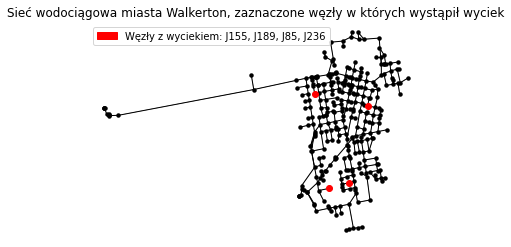

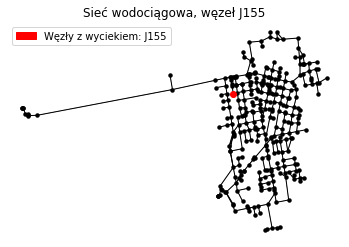

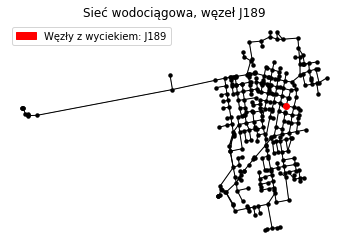

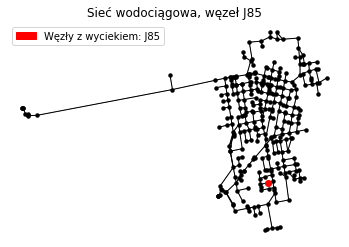

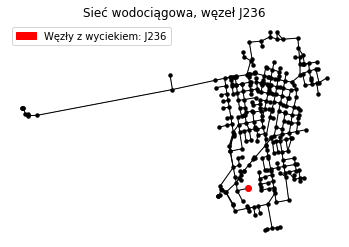

In [4]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import wntr

def plot_network_with_leak_nodes(wn, title, leak_nodes):
    """Rysuje sieć wodociągową z zaznaczonymi węzłami wycieku."""
    fig, ax = plt.subplots()
    wntr.graphics.plot_network(wn, title=title, ax=ax)
    
    for node_name in leak_nodes:
        node = wn.get_node(node_name)
        ax.plot(node.coordinates[0], node.coordinates[1], 'ro', markersize=6)
    
    leak_legend = mpatches.Patch(color='red', label=f"Węzły z wyciekiem: {', '.join(leak_nodes)}")
    plt.legend(handles=[leak_legend])
    plt.show()

# Wczytanie modelu sieci wodociągowej
wn = wntr.network.WaterNetworkModel(inp_file)

# Lista węzłów z wyciekiem
leak_nodes = ['J155', 'J189', 'J85', 'J236']

# Wykres dla wszystkich węzłów z wyciekiem
plot_network_with_leak_nodes(wn, title='Sieć wodociągowa miasta Walkerton, zaznaczone węzły w których wystąpił wyciek', leak_nodes=leak_nodes)

# Wykresy dla pojedynczych węzłów
for node_name in leak_nodes:
    plot_network_with_leak_nodes(wn, title=f'Sieć wodociągowa, węzeł {node_name}', leak_nodes=[node_name])


# Mapy ciśnienia

C:\Users\wij\Desktop\Inżynierka\WTNR-pipe-leak-detection-main\virWNTR\lib\site-packages\scipy\optimize\minpack.py:829: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


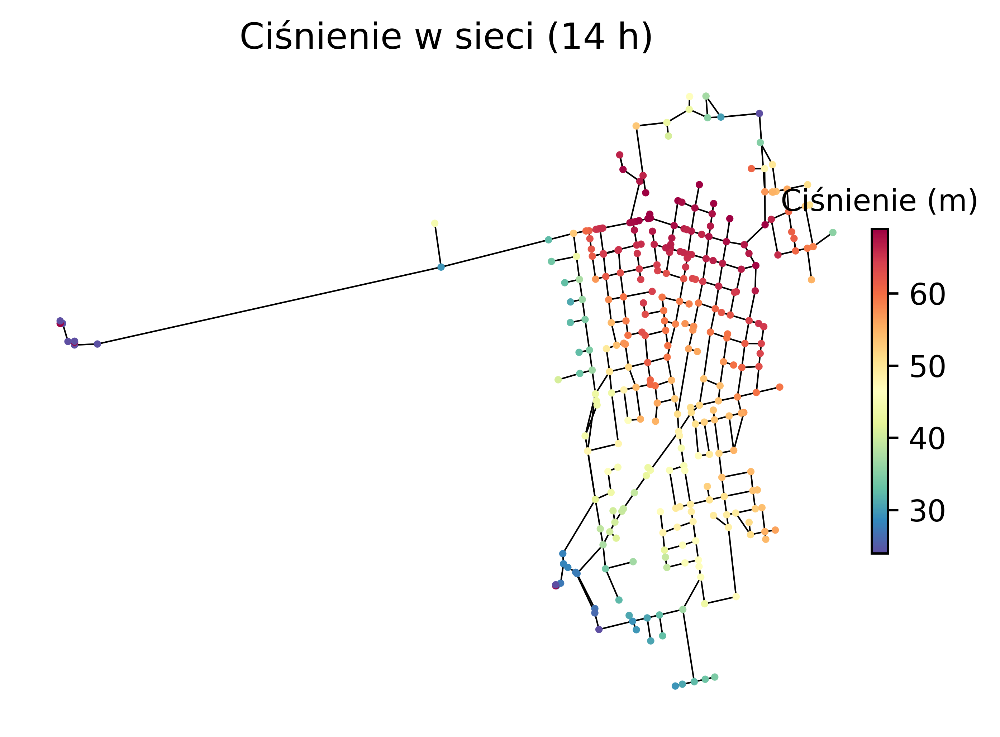

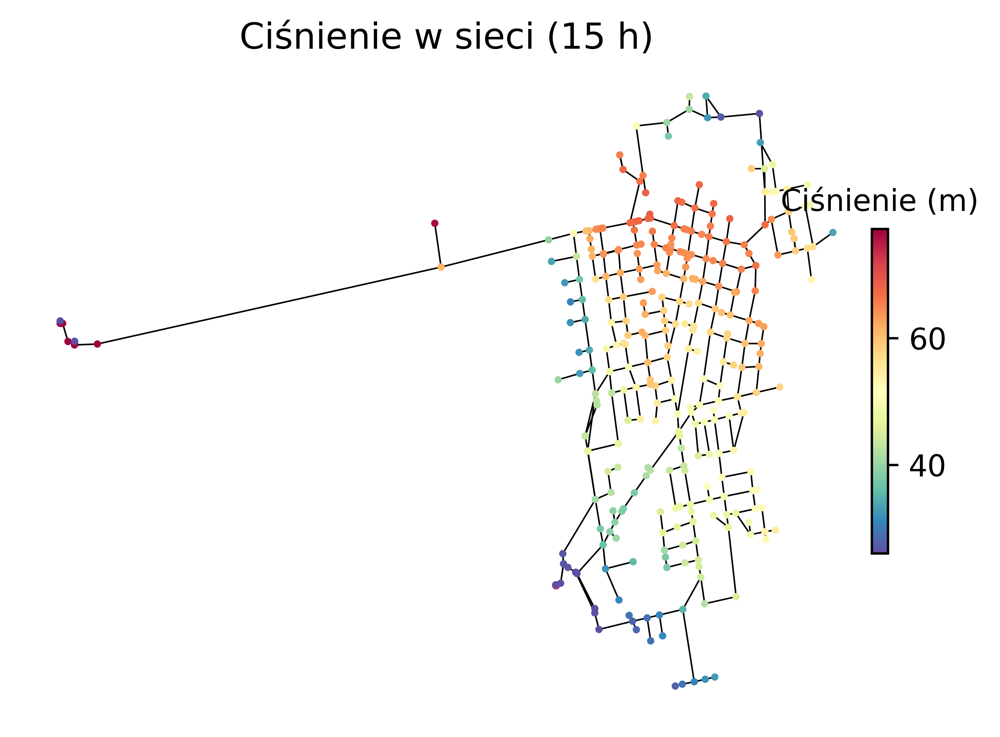

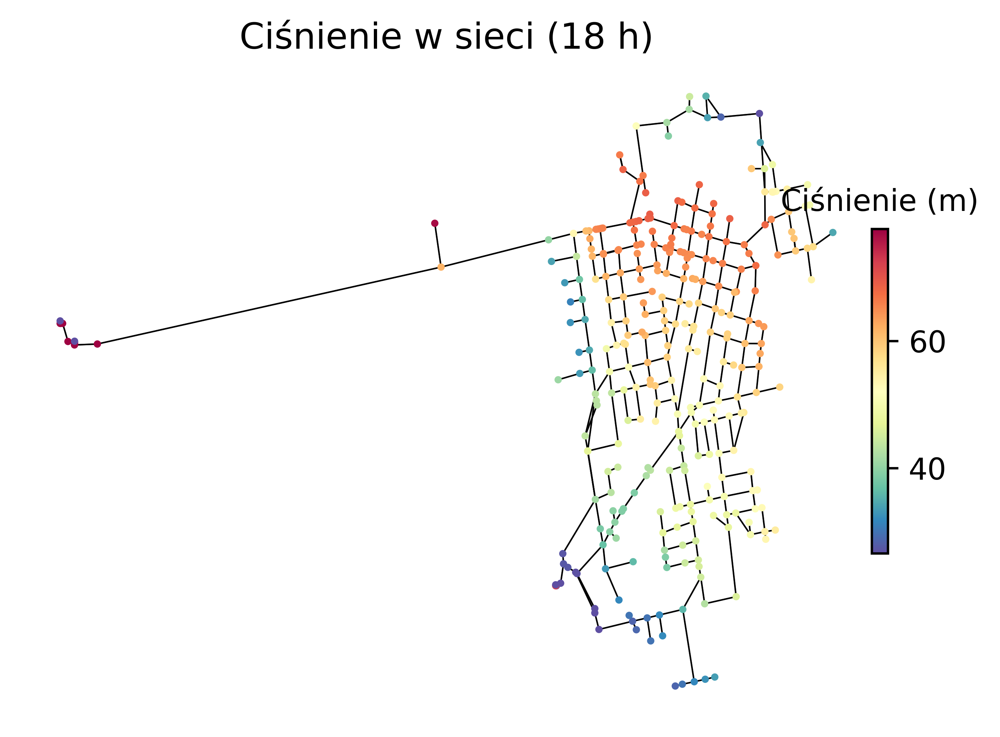

In [5]:
wn = wntr.network.WaterNetworkModel(inp_file)
sim = wntr.sim.WNTRSimulator(wn)
results = sim.run_sim()

# Ustawienia wyświetlania
plt.rcParams['figure.dpi'] = 600

# Definiowanie funkcji, która wyznacza 95% zakres ciśnienia i tworzy wykres
def plot_pressure_at_time(time_in_seconds, title):
    pressure = results.node['pressure'].loc[time_in_seconds, :]

    # Obliczanie zakresu 95% dla ciśnienia (percentyle 2.5 i 97.5)
    pressure_min = pressure.quantile(0.025)
    pressure_max = pressure.quantile(0.975)

    # Tworzenie wykresu dla danego czasu
    ax = wntr.graphics.plot_network(
        wn,
        node_attribute=pressure,
        node_range=[pressure_min, pressure_max],
        node_colorbar_label='Ciśnienie (m)',
        node_size=6,
        link_width=0.5
    )
    plt.title(title)
    plt.show()

# Wykresy dla różnych godzin
plot_pressure_at_time(1 * 3600, "Ciśnienie w sieci (14 h)")
plot_pressure_at_time(15 * 3600, "Ciśnienie w sieci (15 h)")
plot_pressure_at_time(18 * 3600, "Ciśnienie w sieci (18 h)")

# Mapy przepływu

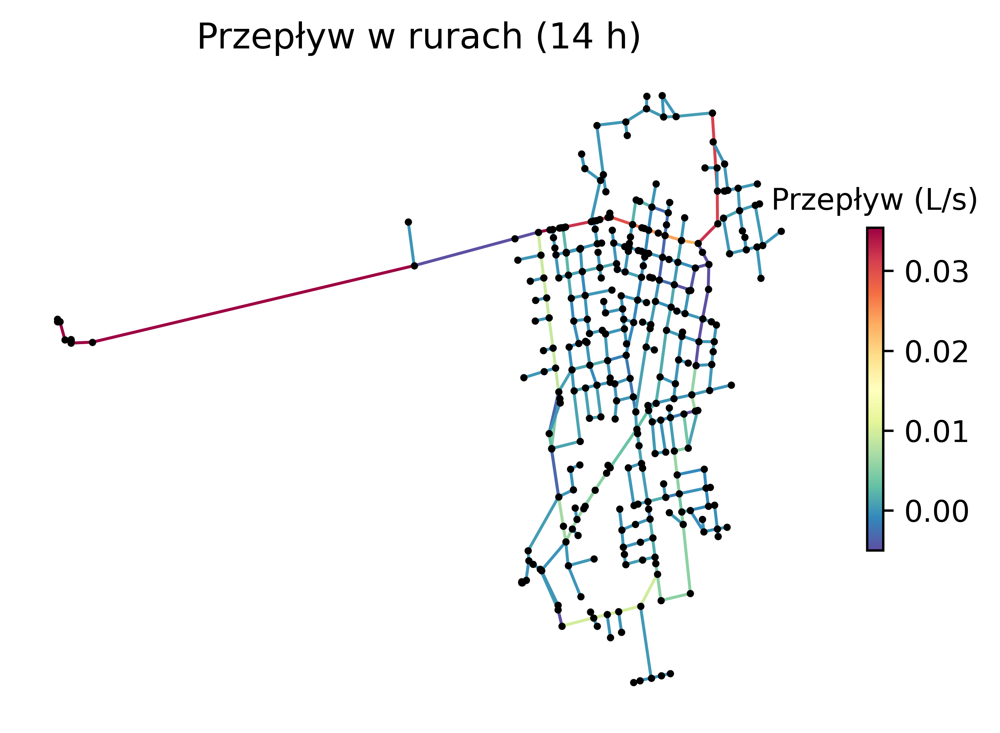

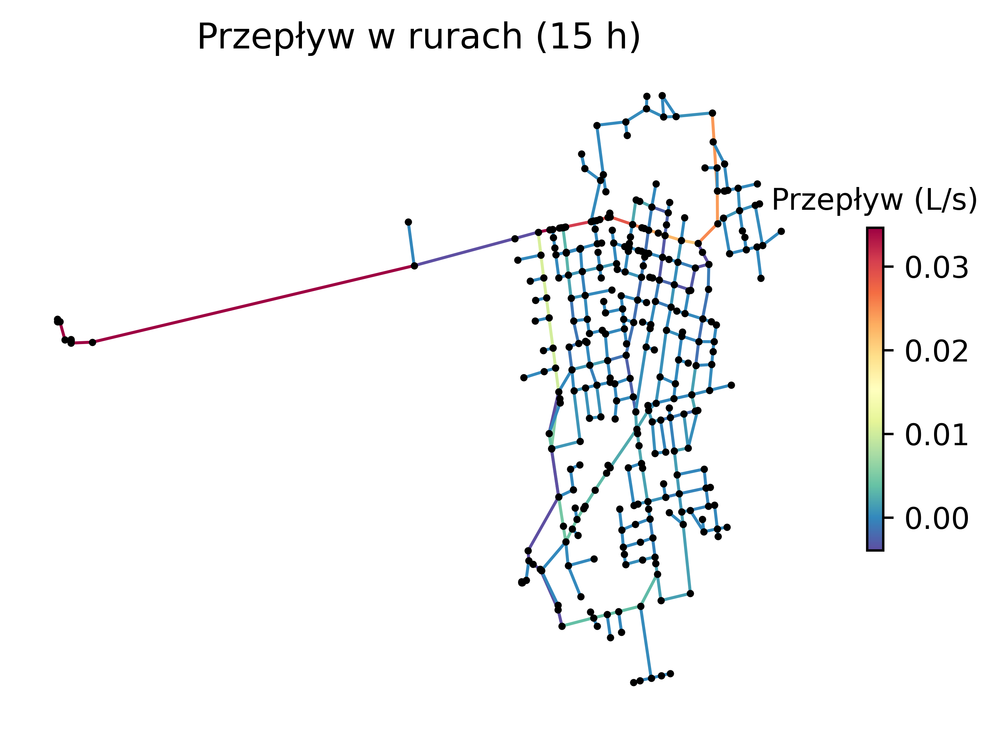

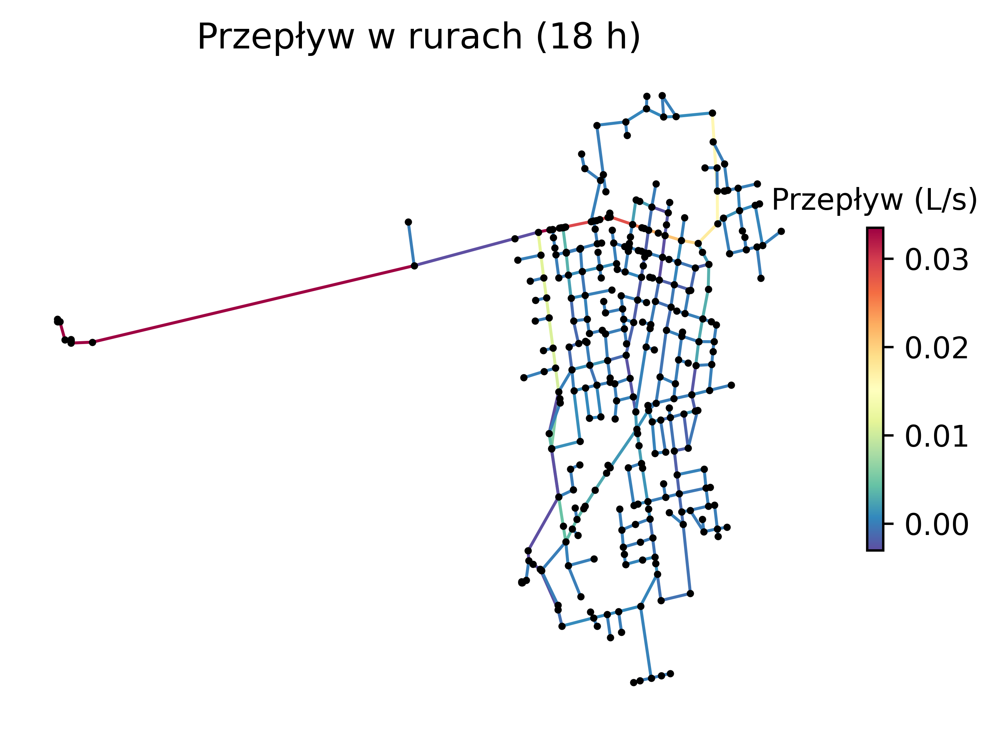

In [6]:
# Ustawienia jakości obrazu
plt.rcParams['figure.dpi'] = 600

# Lista godzin, dla których chcemy zobaczyć przepływ
hours = [14, 15, 18]

# Iteracja przez wybrane godziny
for hour in hours:
    # Oblicz przepływ w danej godzinie
    flow_at_hour = results.link['flowrate'].loc[hour * 3600, :]
    flow_min = flow_at_hour.quantile(0.025)
    flow_max = flow_at_hour.quantile(0.975)
    
    # Rysowanie sieci z przepływami dla każdej godziny
    ax = wntr.graphics.plot_network(
        wn,
        link_attribute=flow_at_hour,           # Przepływ w linkach
        link_range=[flow_min, flow_max],       # Zakres skali dla przepływów
        link_colorbar_label='Przepływ (L/s)',  # Etykieta dla skali przepływów
        link_width=1,                          # Grubość linii
        node_size=6,                           # Rozmiar węzłów
        title=f"Przepływ w rurach ({hour} h)"  # Tytuł z godziną
    )
    plt.show()


Ciśnienie w węźle J155:
0        58.527213
450      60.432097
900      60.523129
1350     57.049284
1800     57.023661
           ...    
84600    53.506011
85050    53.483799
85500    53.461559
85950    53.439297
86400    53.417017
Name: J155, Length: 193, dtype: float64
Węzły połączone z węzłem J155: {'J143', 'J181'}
Rury połączone z węzłem J155: {'P181', 'P153'}


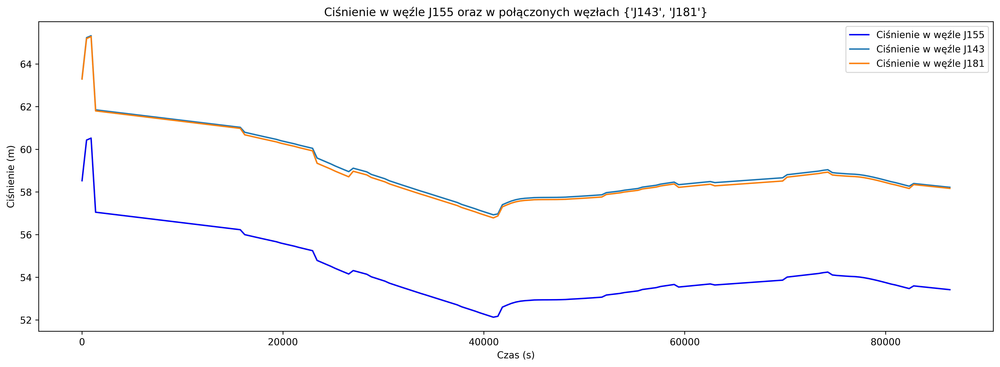

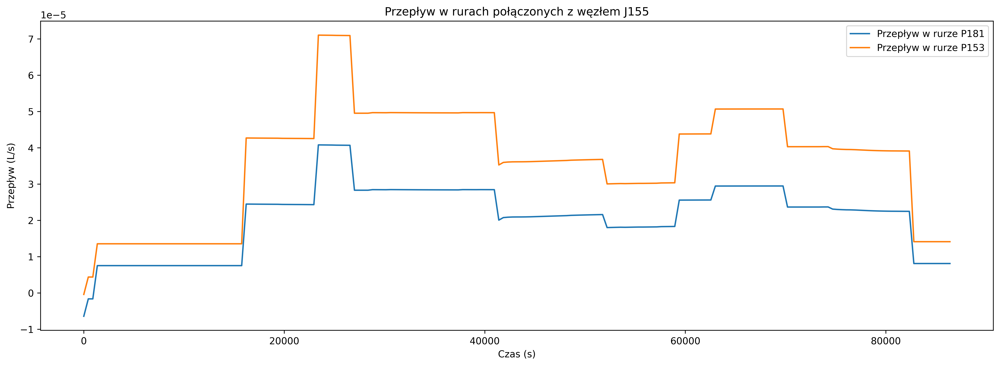

Ciśnienie w węźle J189:
0        62.739156
450      64.410703
900      64.501736
1350     62.331732
1800     62.306109
           ...    
84600    58.787148
85050    58.764917
85500    58.742661
85950    58.720385
86400    58.698095
Name: J189, Length: 193, dtype: float64
Węzły połączone z węzłem J189: {'J225', 'J162', 'J190'}
Rury połączone z węzłem J189: {'P191', 'P190', 'P232'}


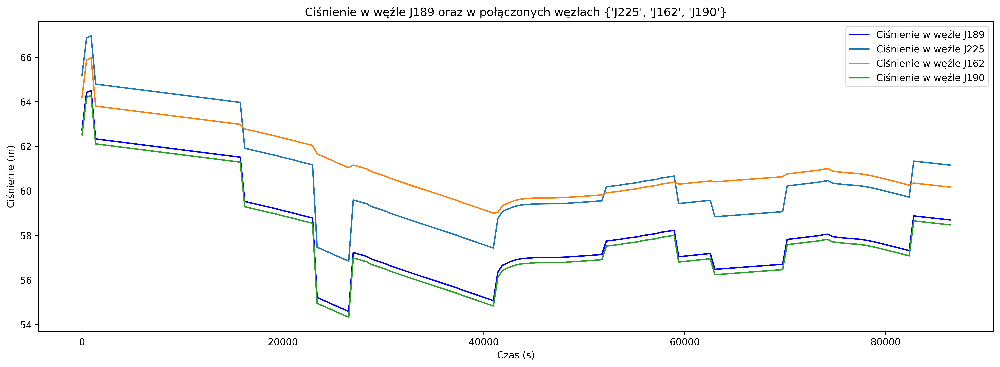

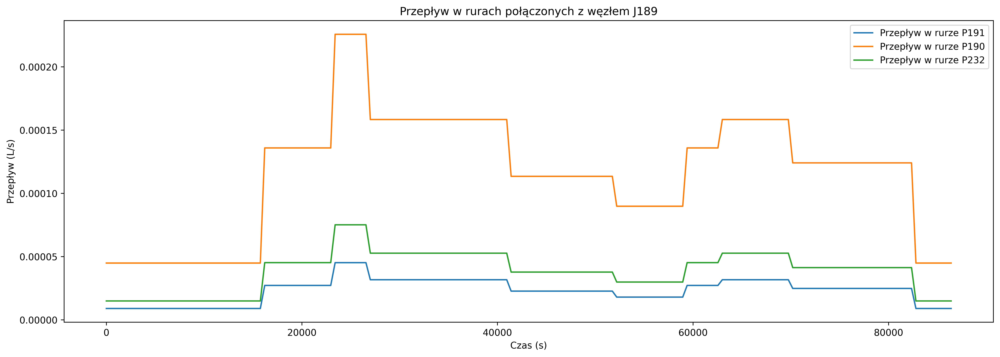

Ciśnienie w węźle J85:
0        45.742798
450      48.304522
900      48.395555
1350     46.099273
1800     46.073650
           ...    
84600    42.576501
85050    42.554325
85500    42.532113
85950    42.509874
86400    42.487613
Name: J85, Length: 193, dtype: float64
Węzły połączone z węzłem J85: {'J76', 'J82'}
Rury połączone z węzłem J85: {'P207', 'P77'}


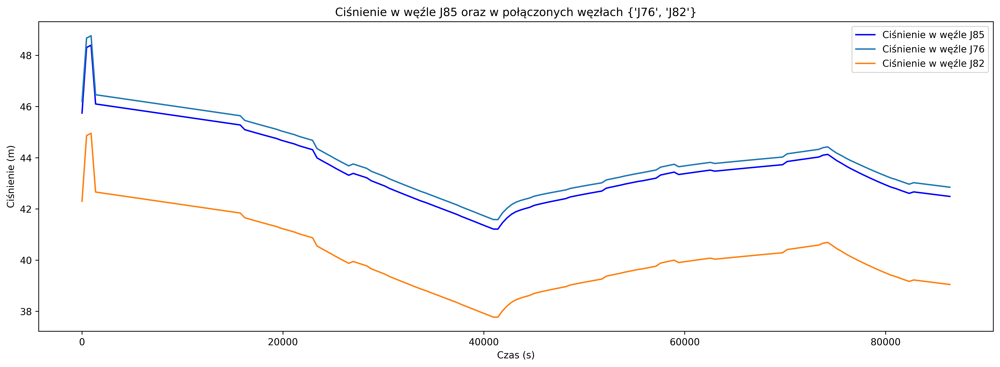

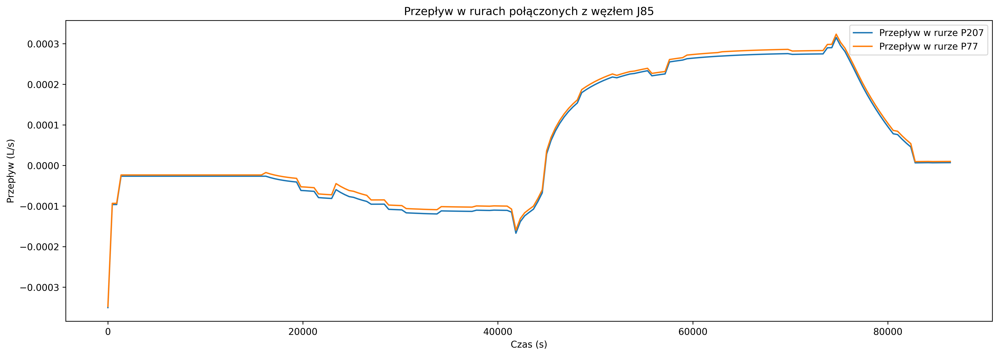

Ciśnienie w węźle J236:
0        37.773809
450      40.077634
900      40.168667
1350     37.096163
1800     37.070539
           ...    
84600    33.567089
85050    33.544894
85500    33.522669
85950    33.500417
86400    33.478146
Name: J236, Length: 193, dtype: float64
Węzły połączone z węzłem J236: {'J68'}
Rury połączone z węzłem J236: {'P251'}


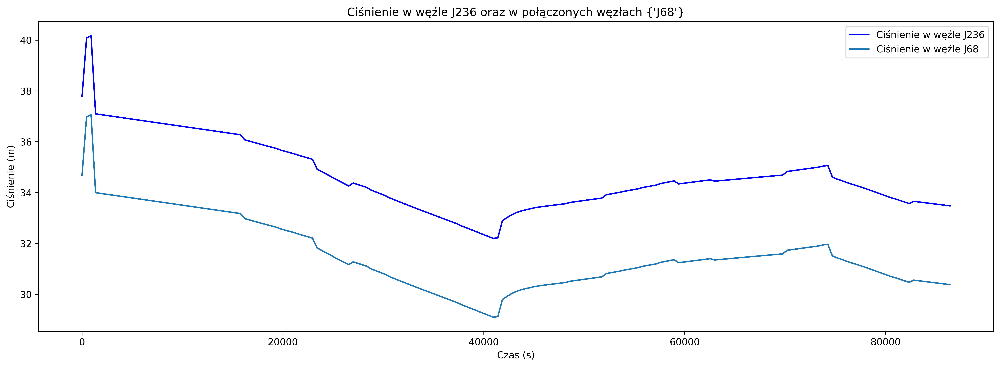

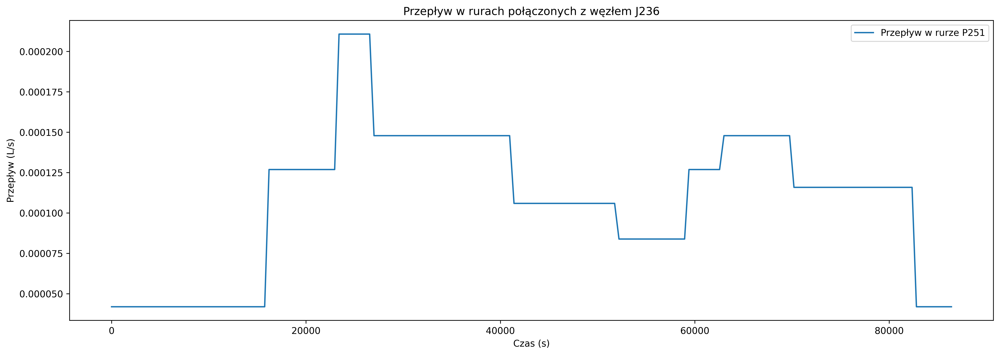

In [7]:
for leak_node_number in leak_nodes:
    wn = wntr.network.WaterNetworkModel(inp_file)
    
    # Ustawienie opcji symulacji
    wn.options.time.duration = duration
    wn.options.time.hydraulic_timestep = 450
    wn.options.time.quality_timestep = 450
    wn.options.time.report_timestep = 450
    
    # Uruchomienie symulacji
    sim = wntr.sim.WNTRSimulator(wn)
    results = sim.run_sim()
    
    # Wyciągnięcie i rysowanie ciśnienia w węźle z wyciekiem oraz węzłach połączonych
    pressure_at_main_node = results.node['pressure'].loc[:, leak_node_number]
    print(f'Ciśnienie w węźle {leak_node_number}:')
    print(pressure_at_main_node)
    
    # Pobranie połączonych węzłów i rur dla bieżącego węzła z wyciekiem
    connected_nodes = set()
    connected_links = set()
    for pipe_name, pipe in wn.links():
        if pipe.start_node_name == leak_node_number:
            connected_nodes.add(pipe.end_node_name)
            connected_links.add(pipe_name)
        elif pipe.end_node_name == leak_node_number:
            connected_nodes.add(pipe.start_node_name)
            connected_links.add(pipe_name)
    
    print(f'Węzły połączone z węzłem {leak_node_number}: {connected_nodes}')
    print(f'Rury połączone z węzłem {leak_node_number}: {connected_links}')
    
    # Rysowanie ciśnienia dla węzła z wyciekiem i jego połączonych węzłów
    fig, ax1 = plt.subplots(figsize=(18, 6))
    ax1.plot(pressure_at_main_node, label=f"Ciśnienie w węźle {leak_node_number}", color="blue")
    
    for connected_node in connected_nodes:
        pressure_at_connected_node = results.node['pressure'].loc[:, connected_node]
        ax1.plot(pressure_at_connected_node, label=f"Ciśnienie w węźle {connected_node}")
    
    ax1.set_title(f"Ciśnienie w węźle {leak_node_number} oraz w połączonych węzłach {connected_nodes}")
    ax1.set_xlabel("Czas (s)")
    ax1.set_ylabel("Ciśnienie (m)")
    ax1.legend()
    
    # Rysowanie przepływów dla rur połączonych z węzłem z wyciekiem
    fig, ax2 = plt.subplots(figsize=(18, 6))
    for link in connected_links:
        flowrate_at_link = results.link['flowrate'].loc[:, link]
        ax2.plot(flowrate_at_link, label=f"Przepływ w rurze {link}")
    
    ax2.set_title(f"Przepływ w rurach połączonych z węzłem {leak_node_number}")
    ax2.set_xlabel("Czas (s)")
    ax2.set_ylabel("Przepływ (L/s)")
    ax2.legend()
    
    plt.show()


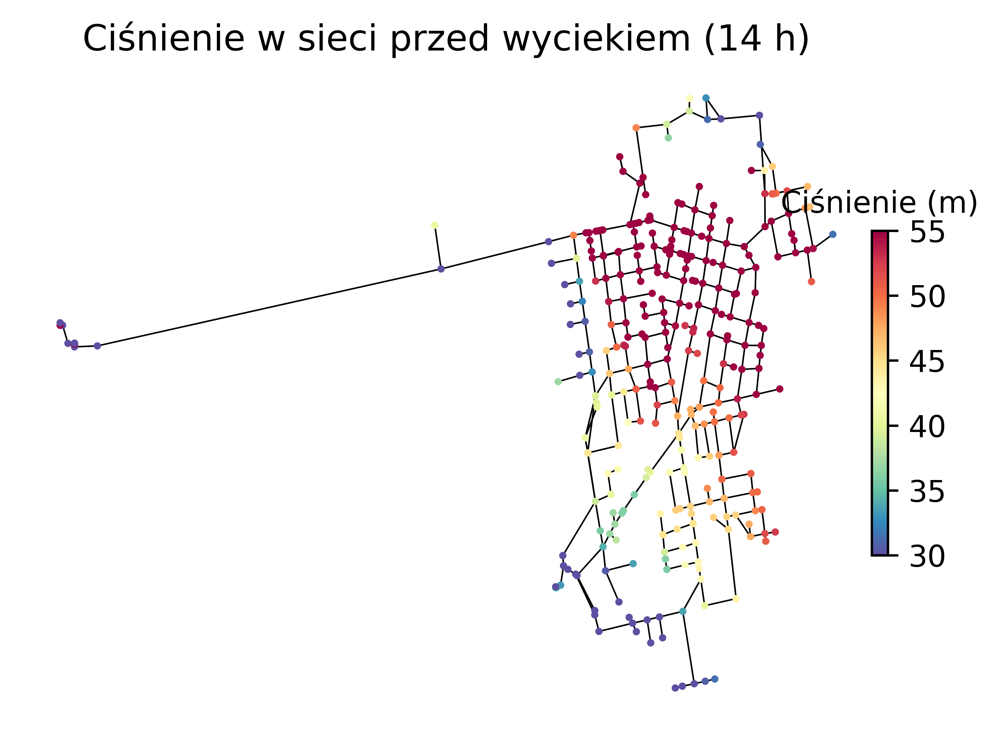

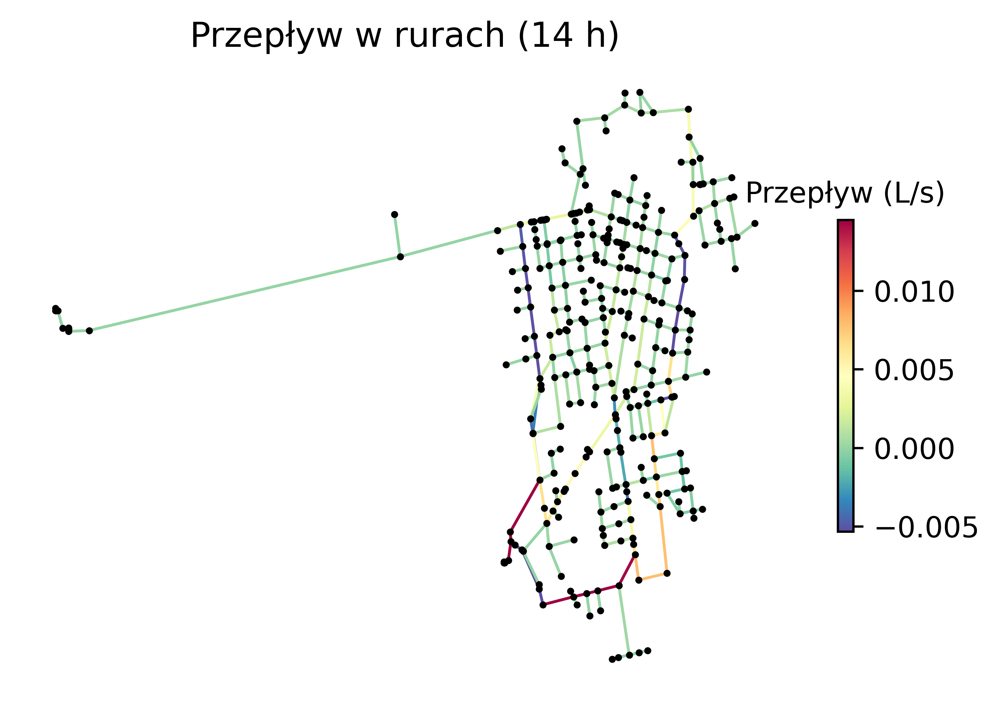

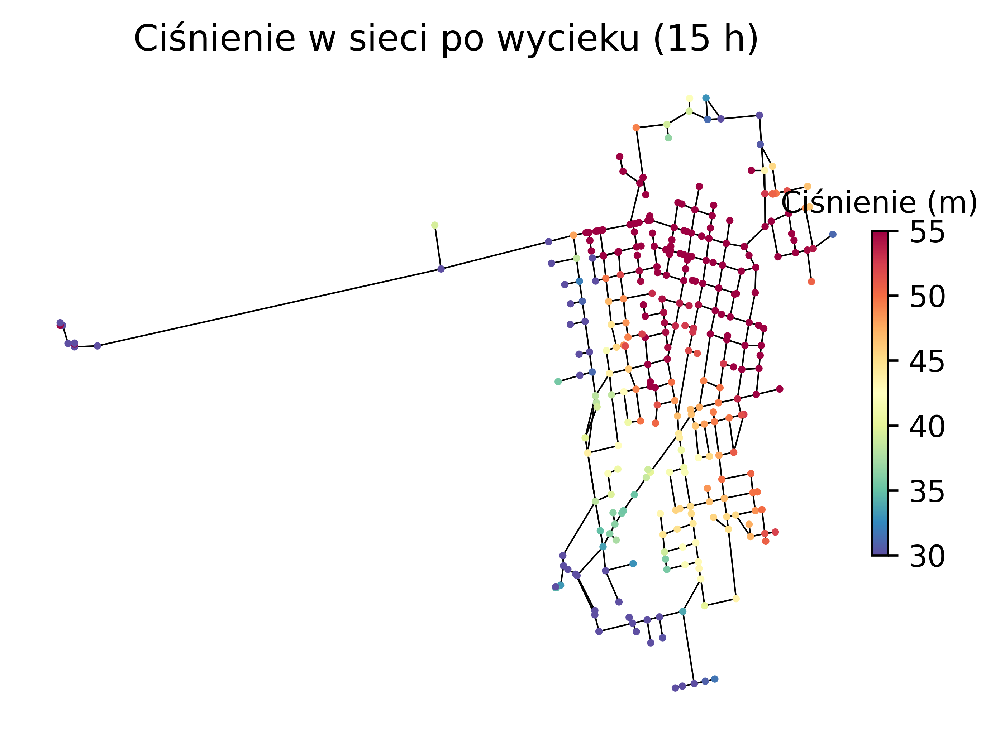

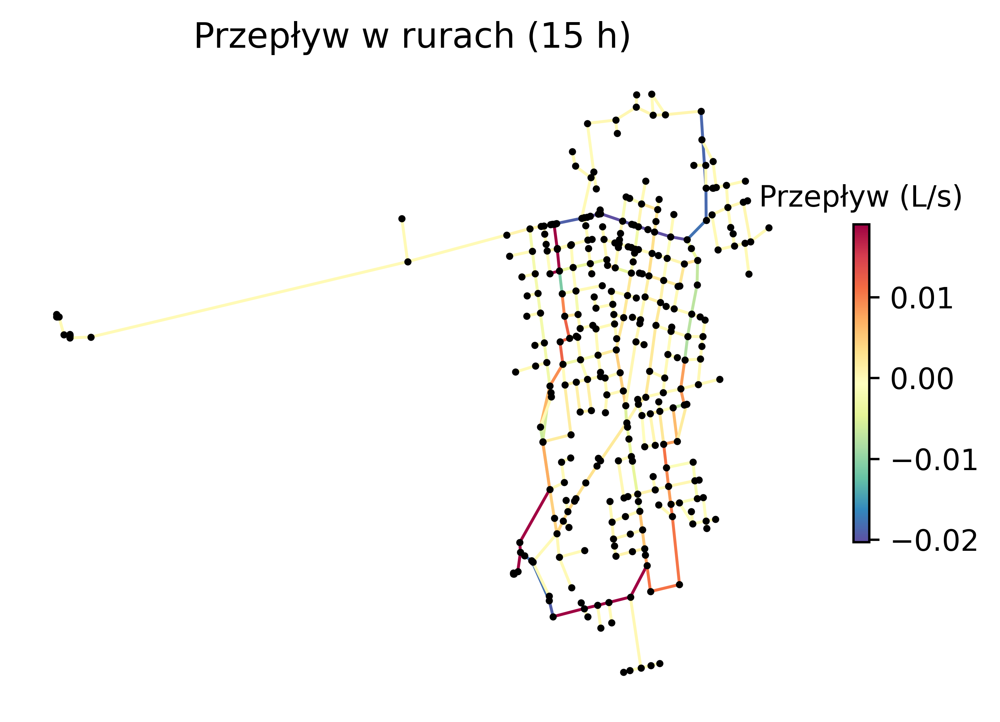

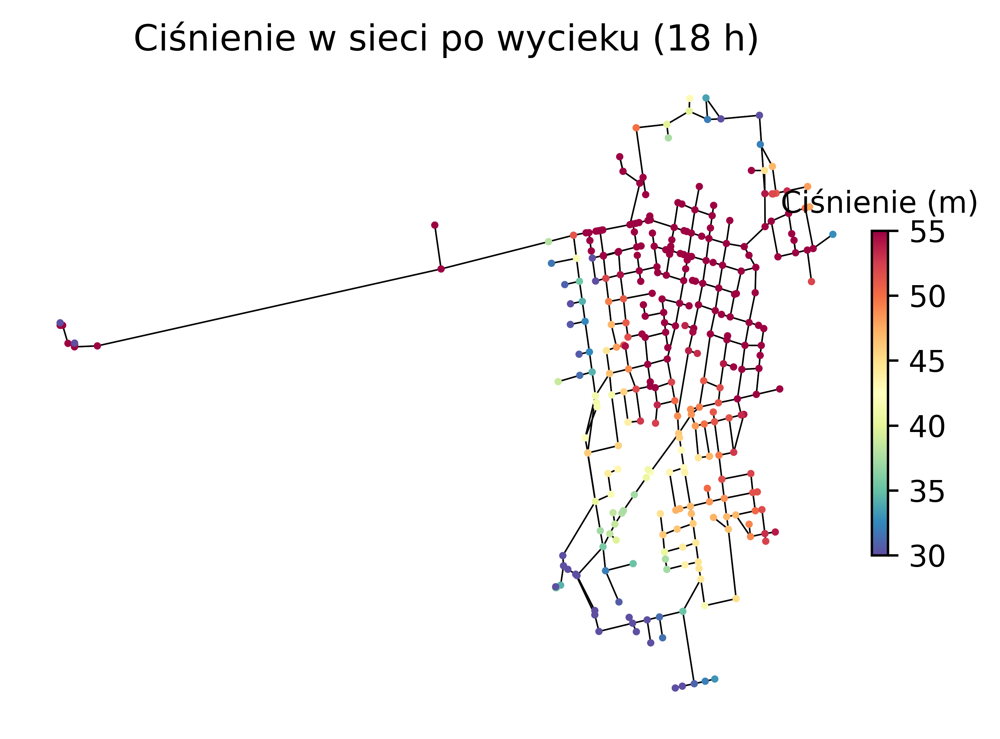

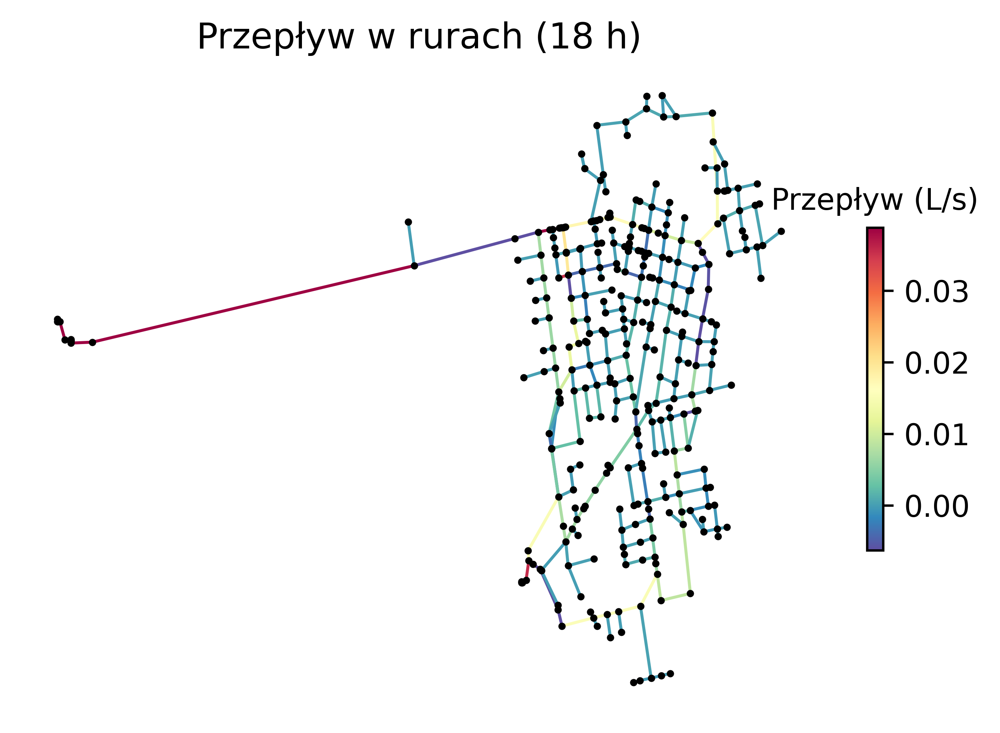

Węzły połączone z węzłem J155: {'J143', 'J181'}
Rury połączone z węzłem J155: {'P181', 'P153'}


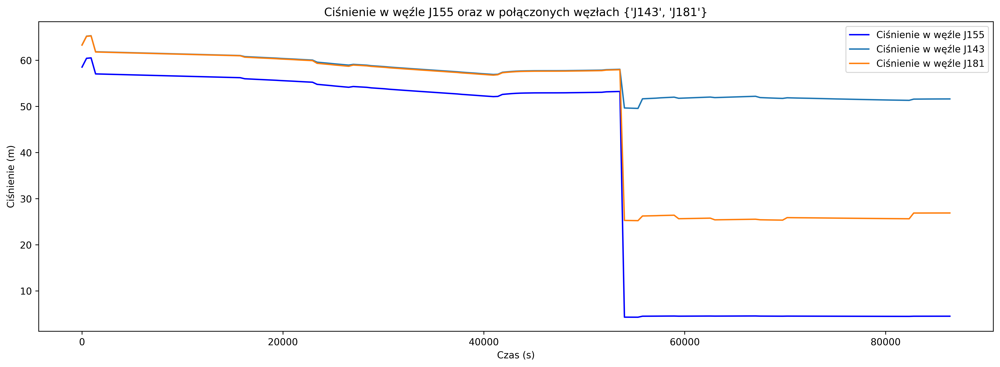

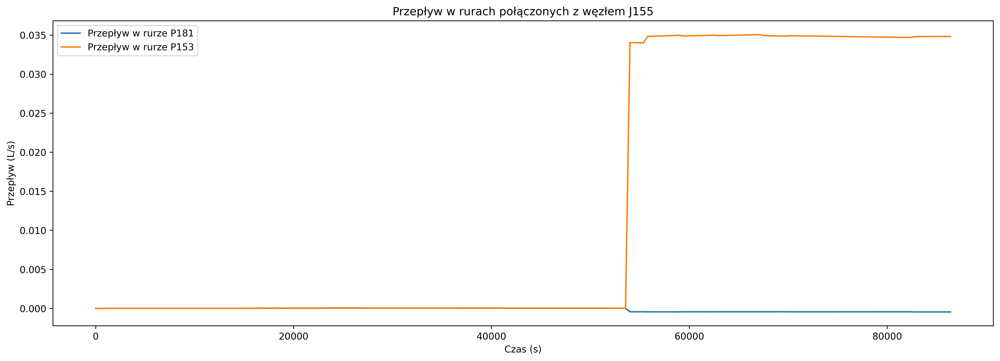

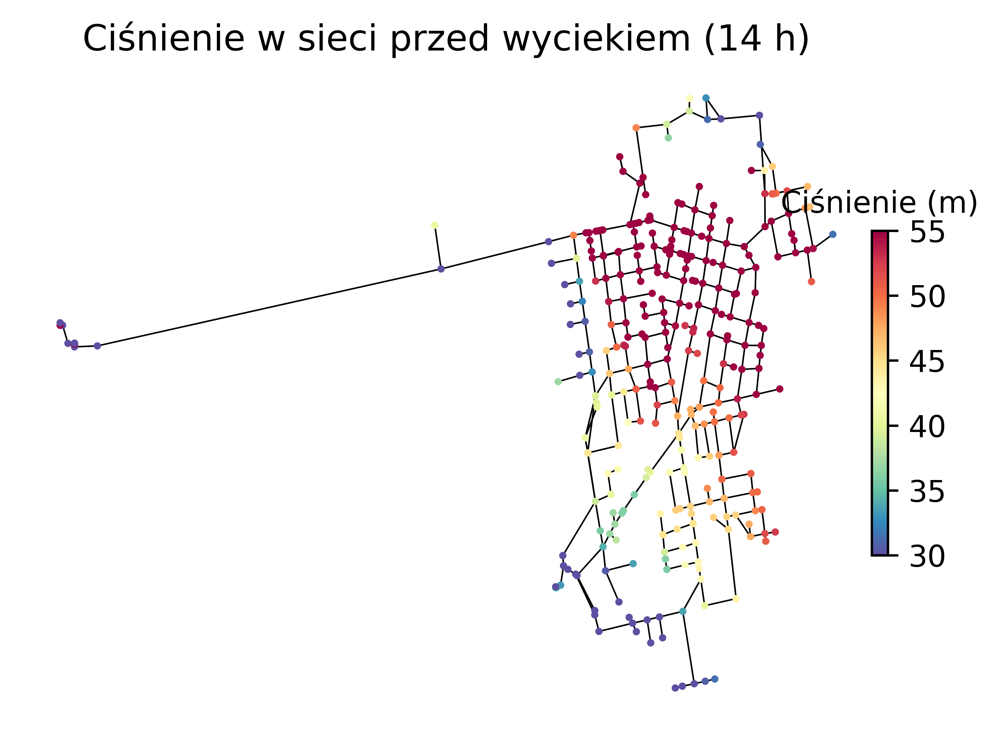

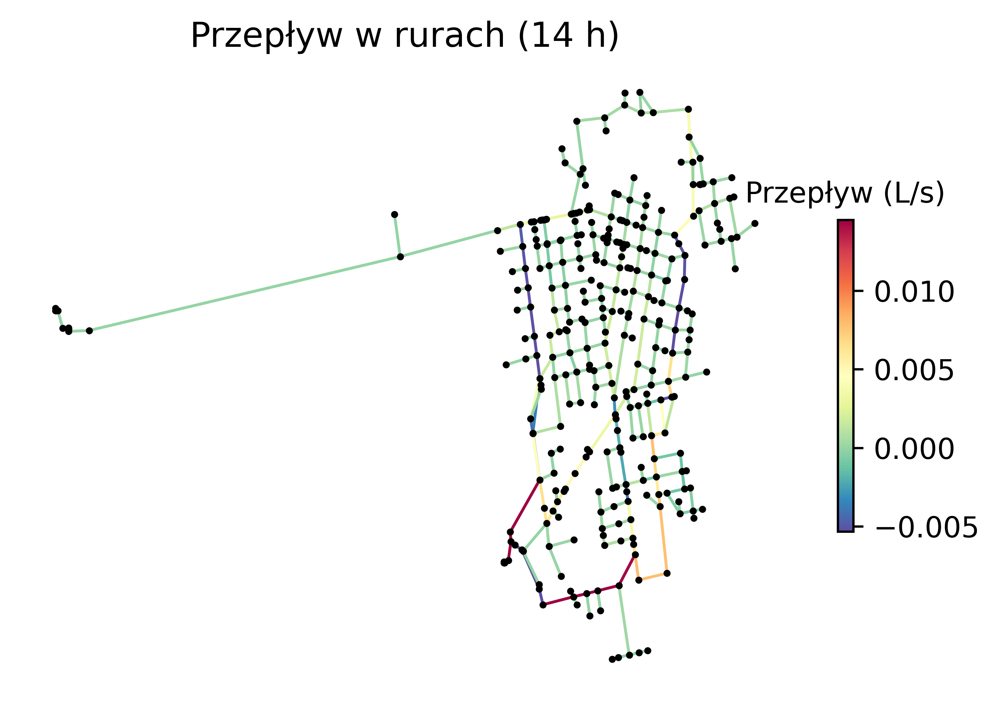

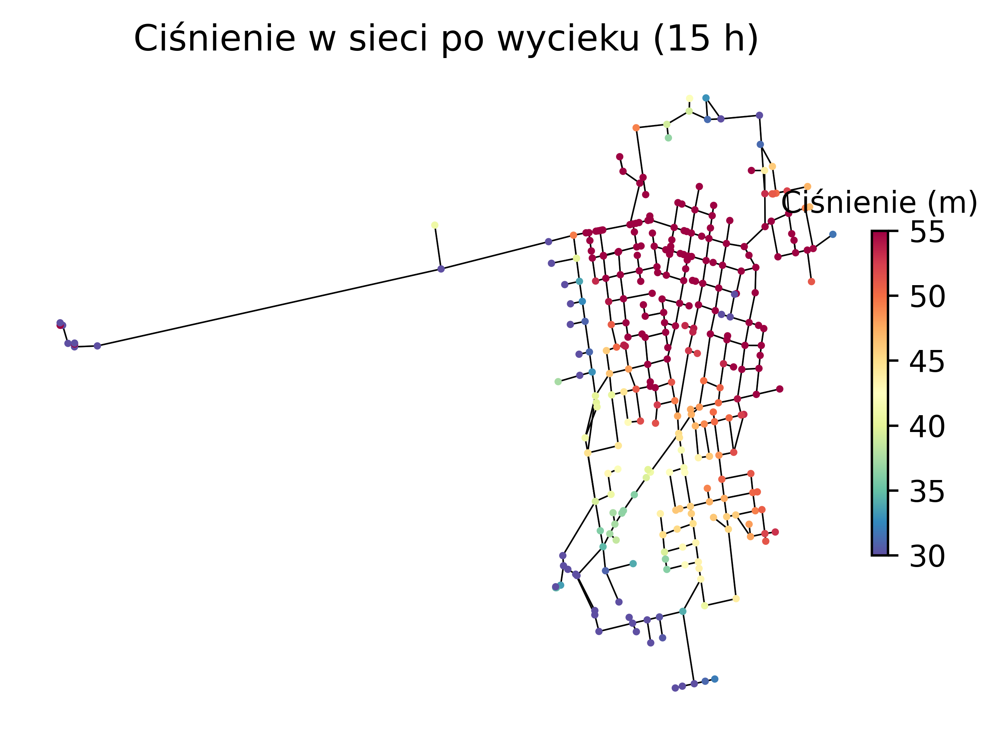

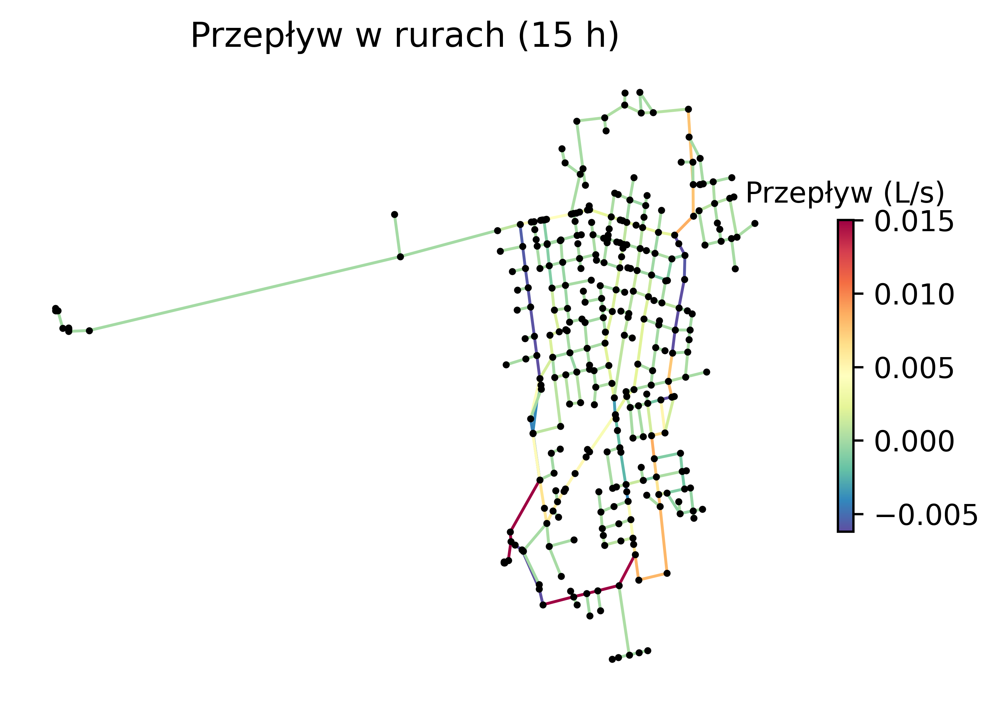

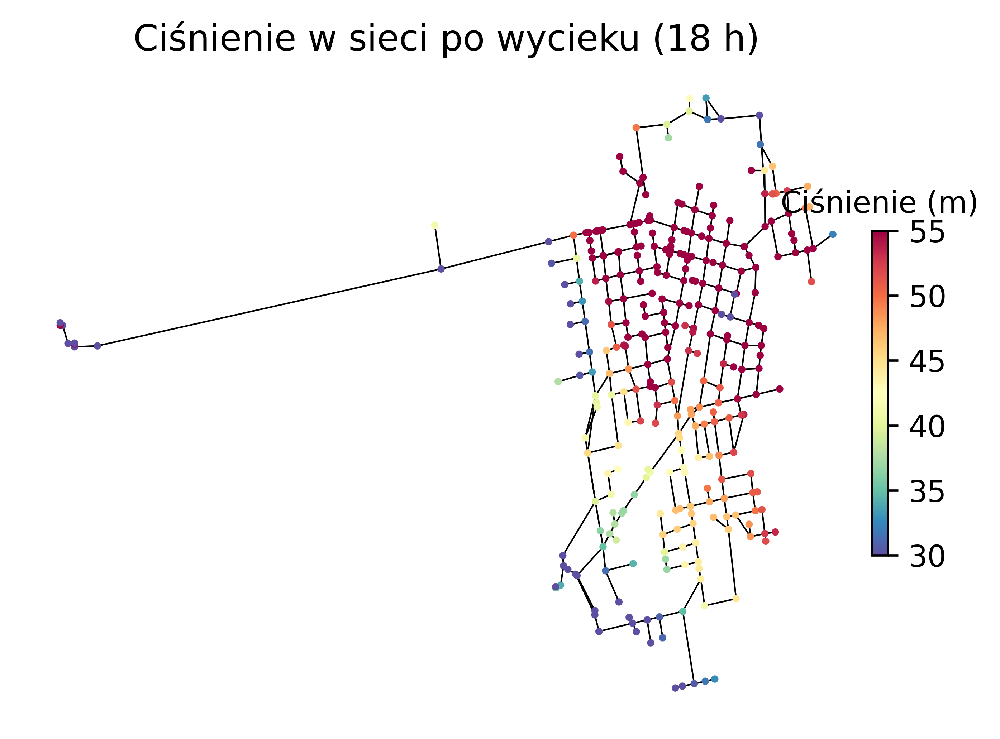

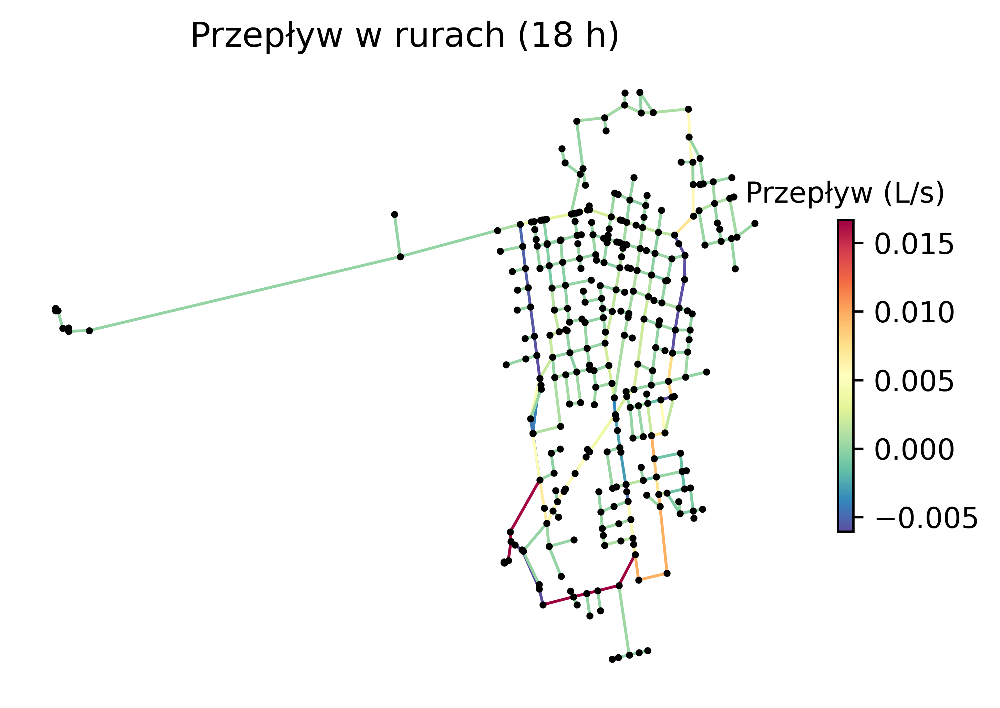

Węzły połączone z węzłem J189: {'J225', 'J162', 'J190'}
Rury połączone z węzłem J189: {'P191', 'P190', 'P232'}


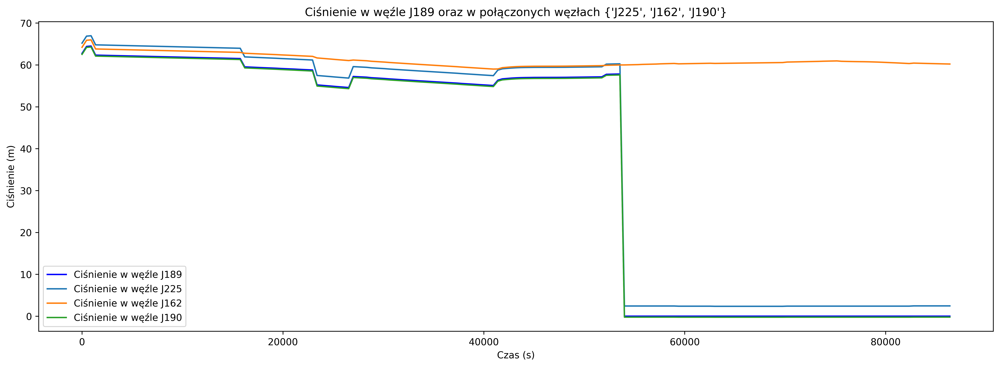

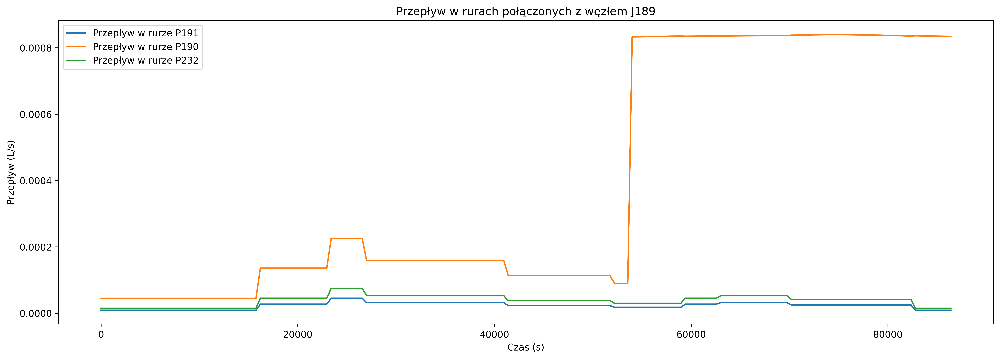

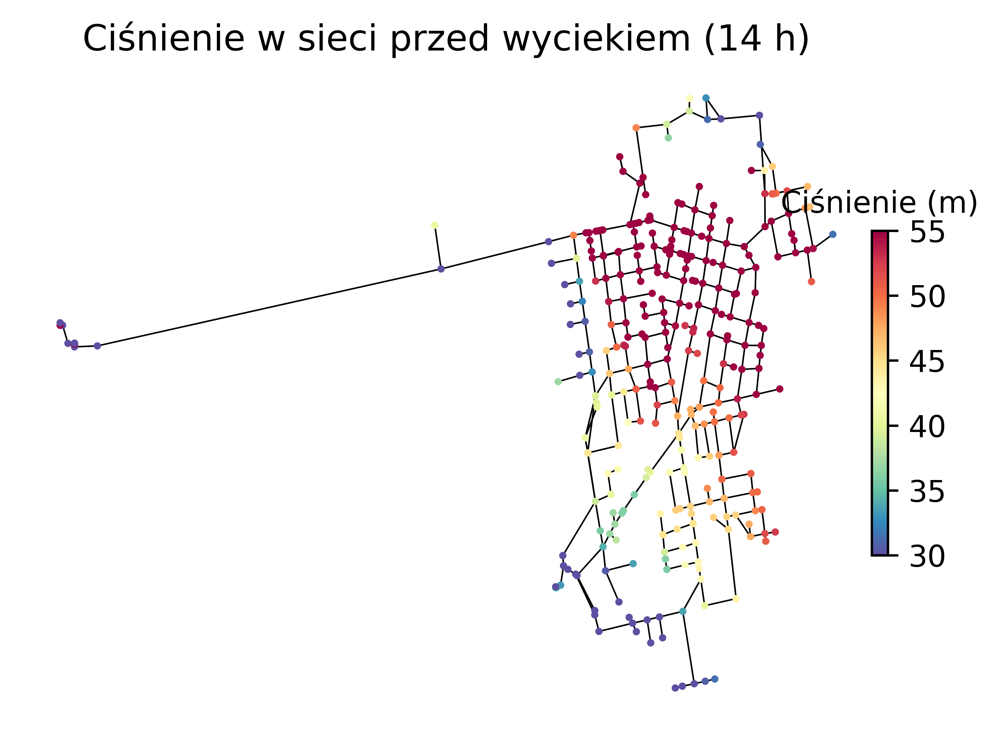

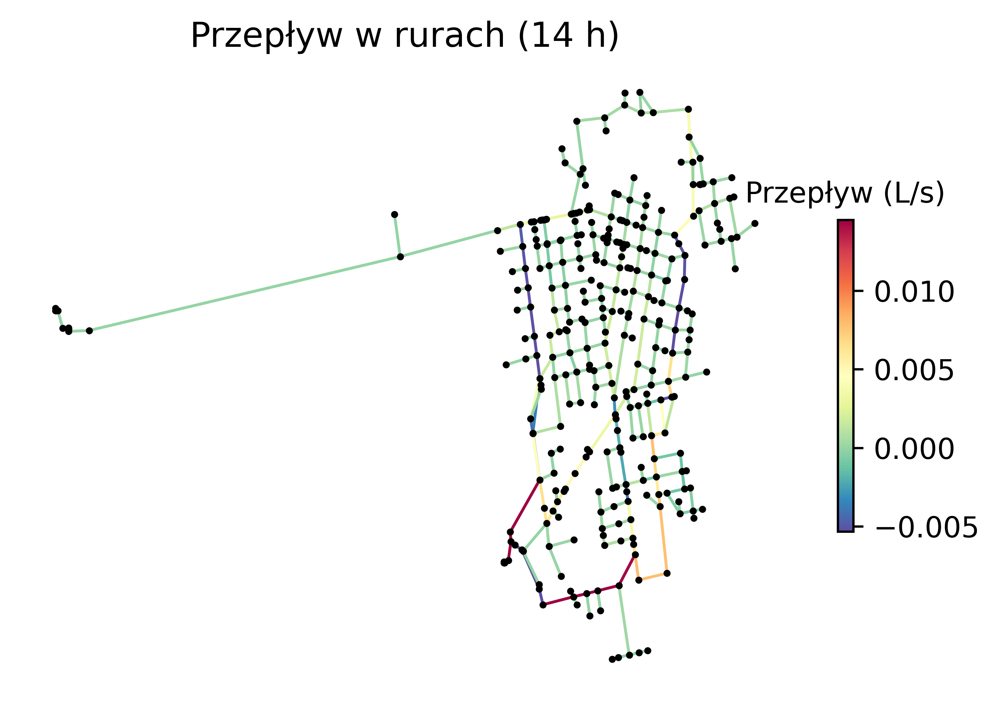

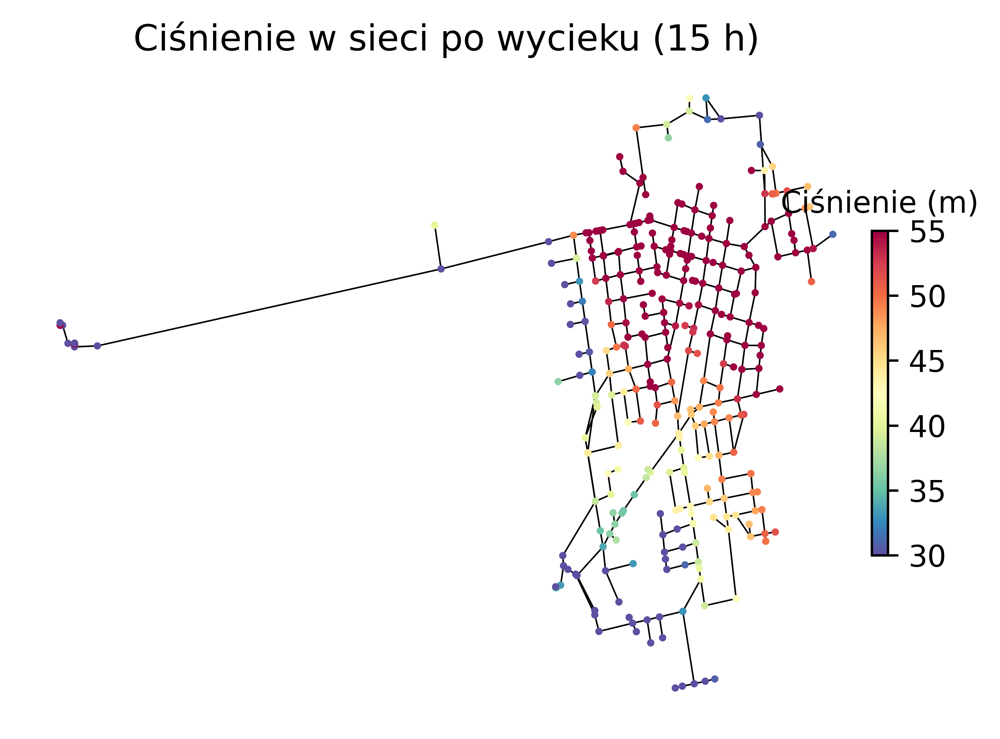

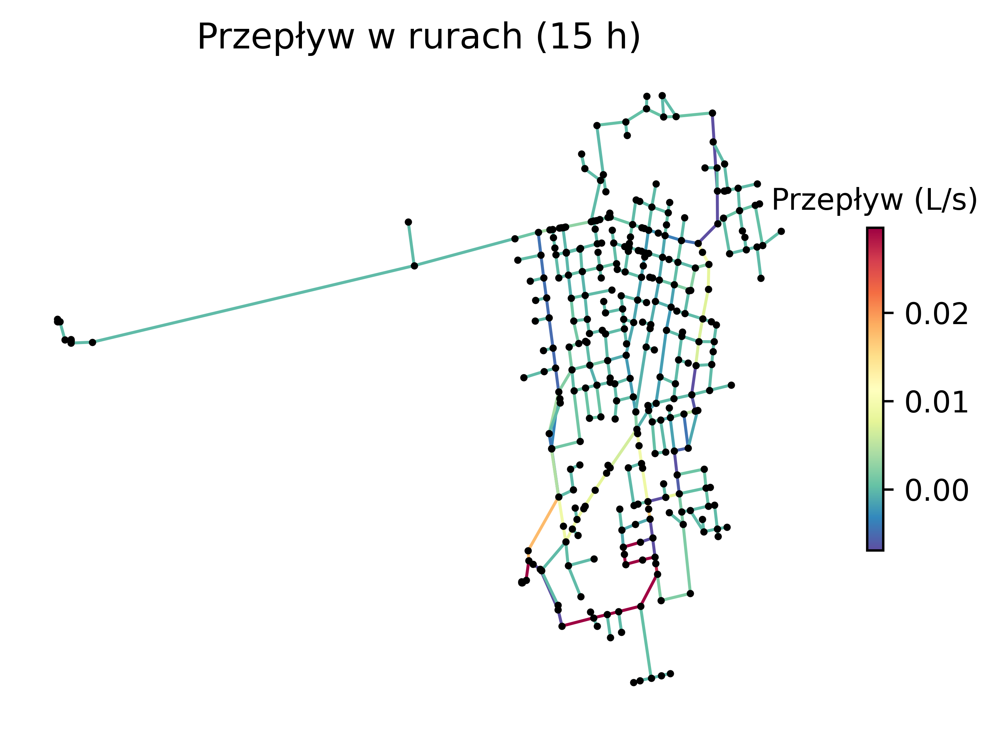

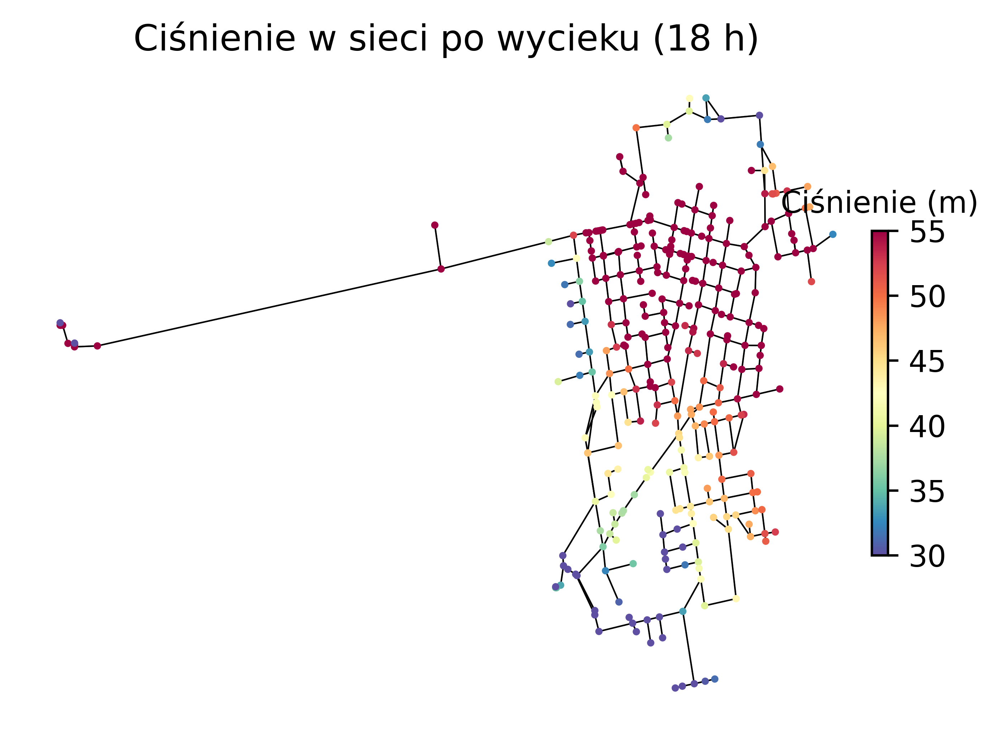

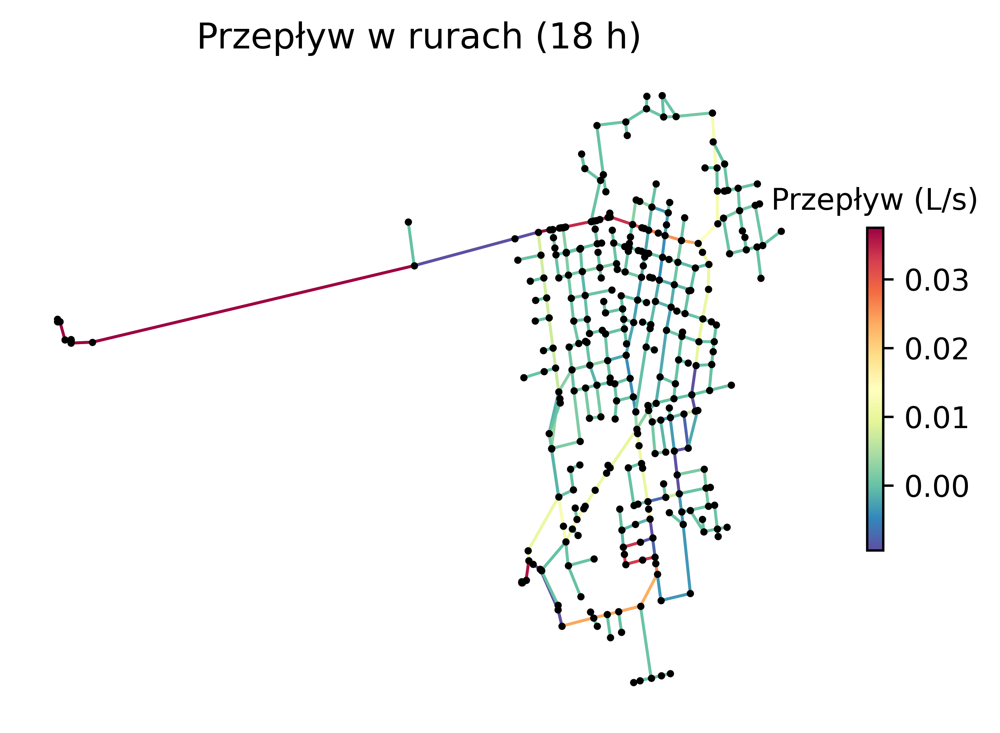

Węzły połączone z węzłem J85: {'J76', 'J82'}
Rury połączone z węzłem J85: {'P207', 'P77'}


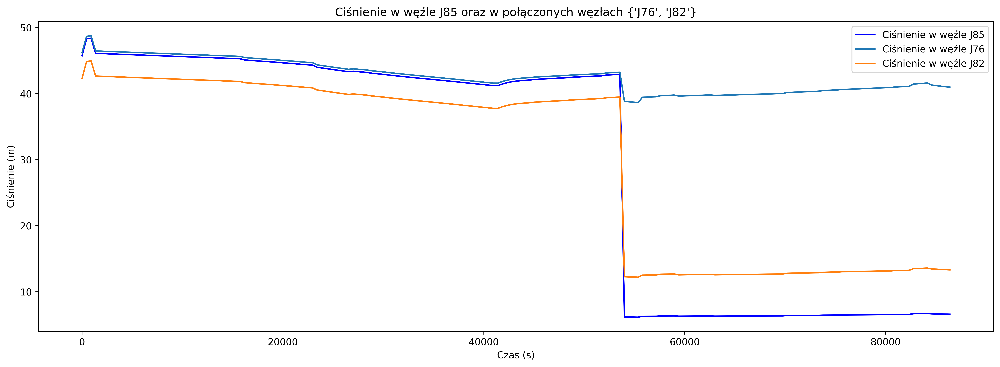

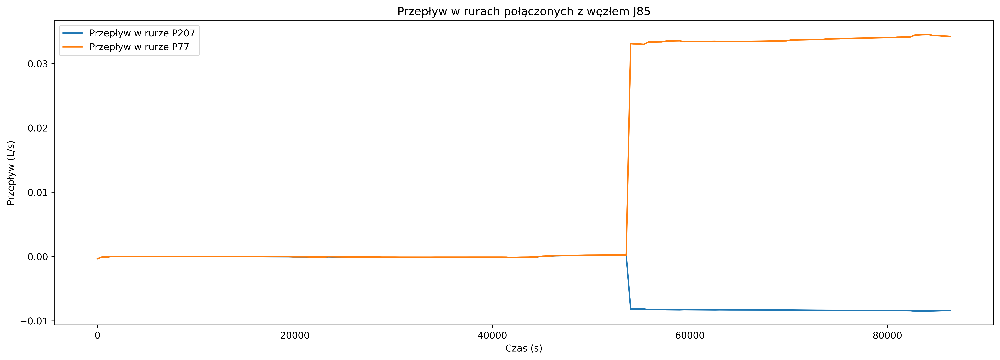

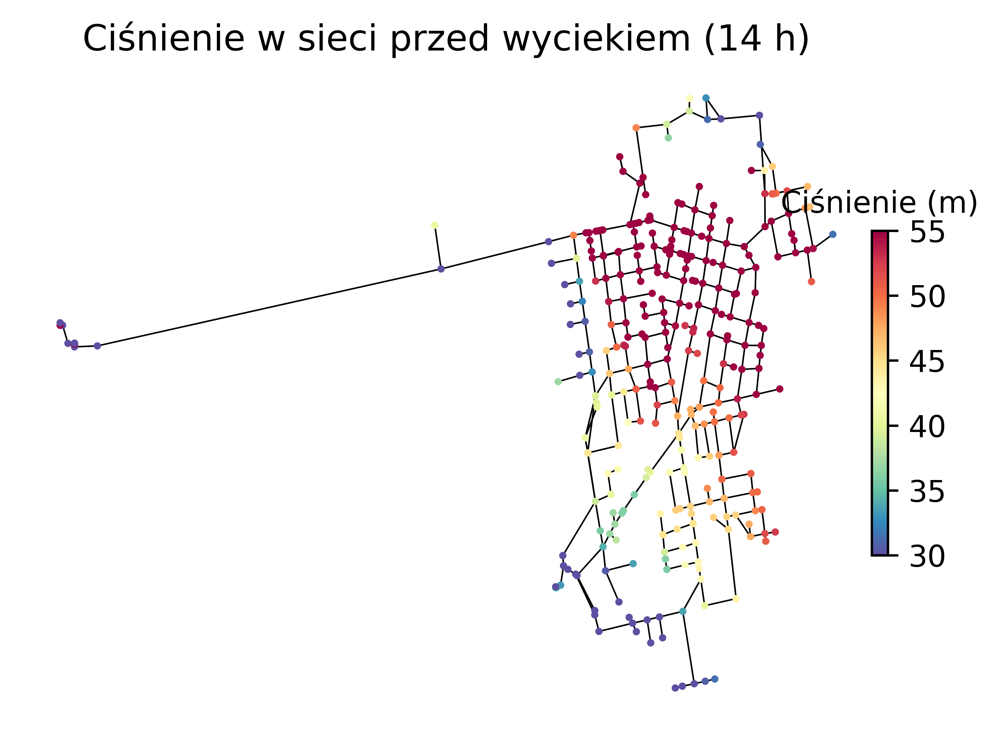

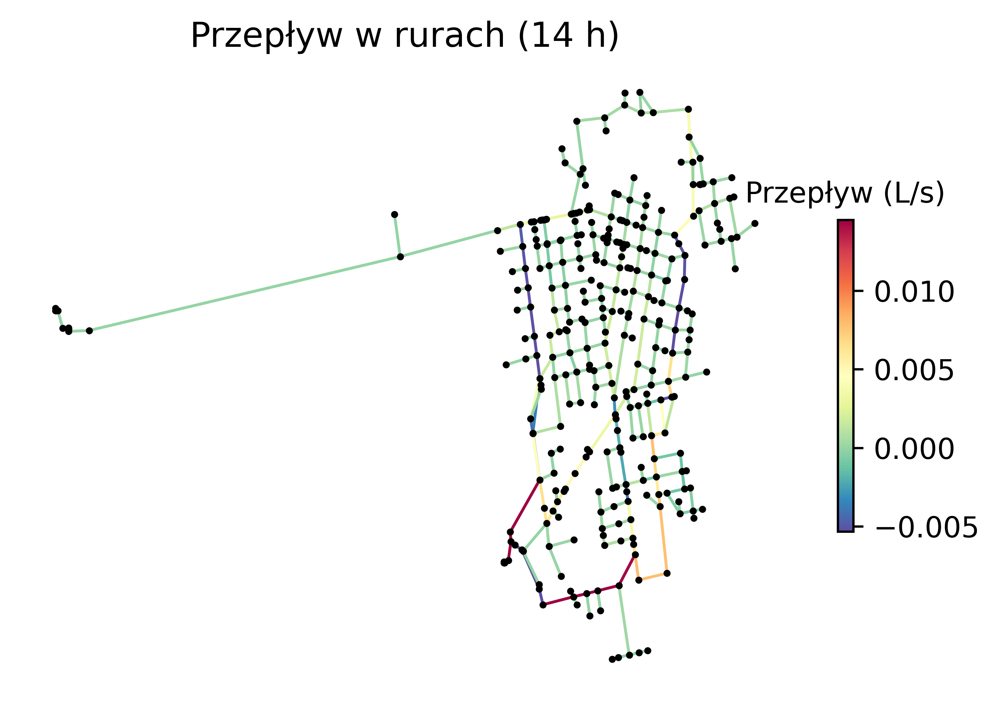

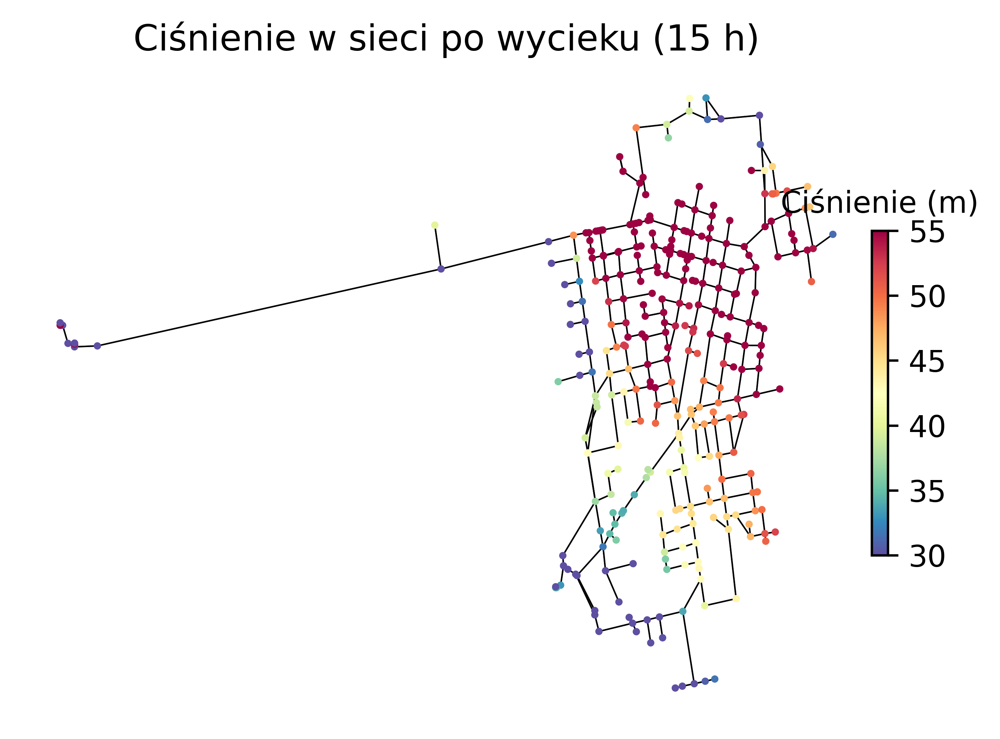

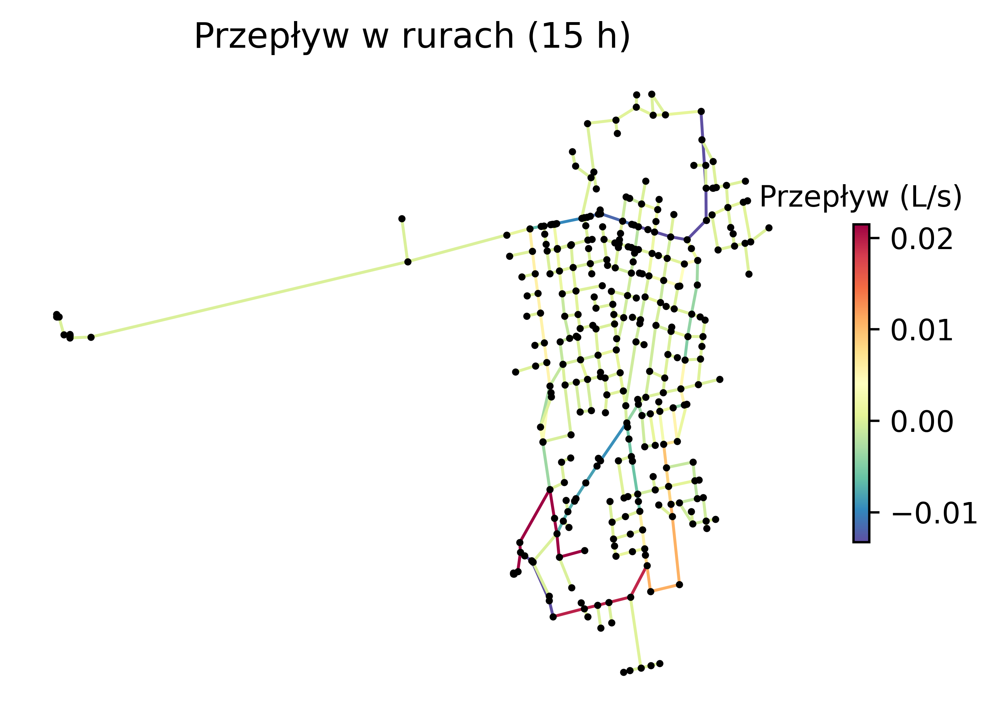

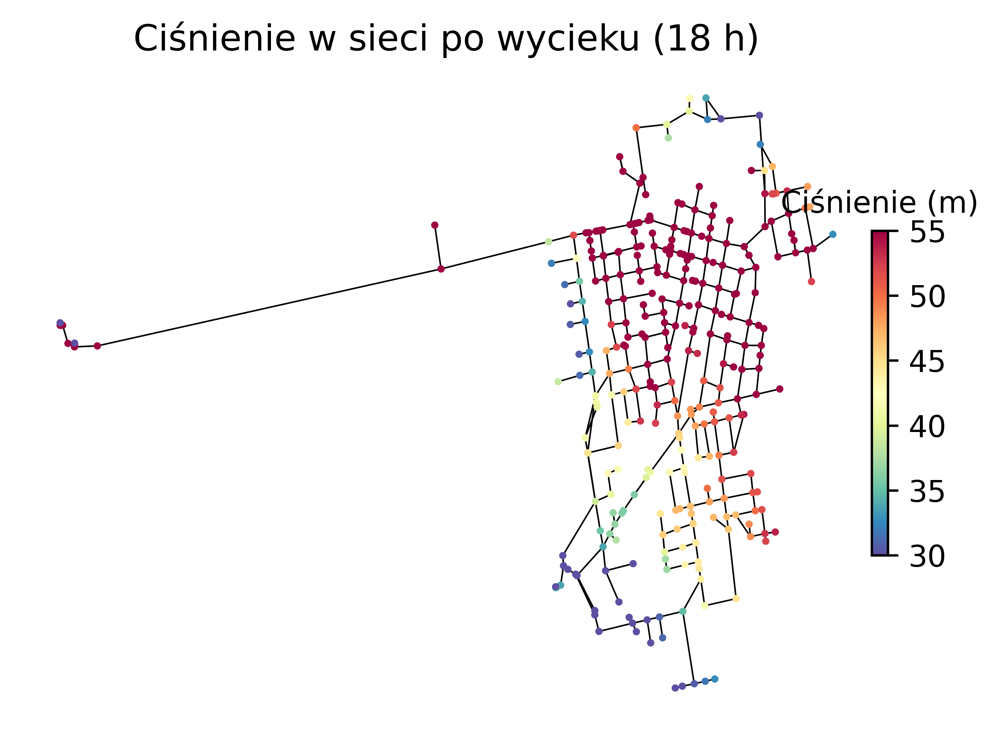

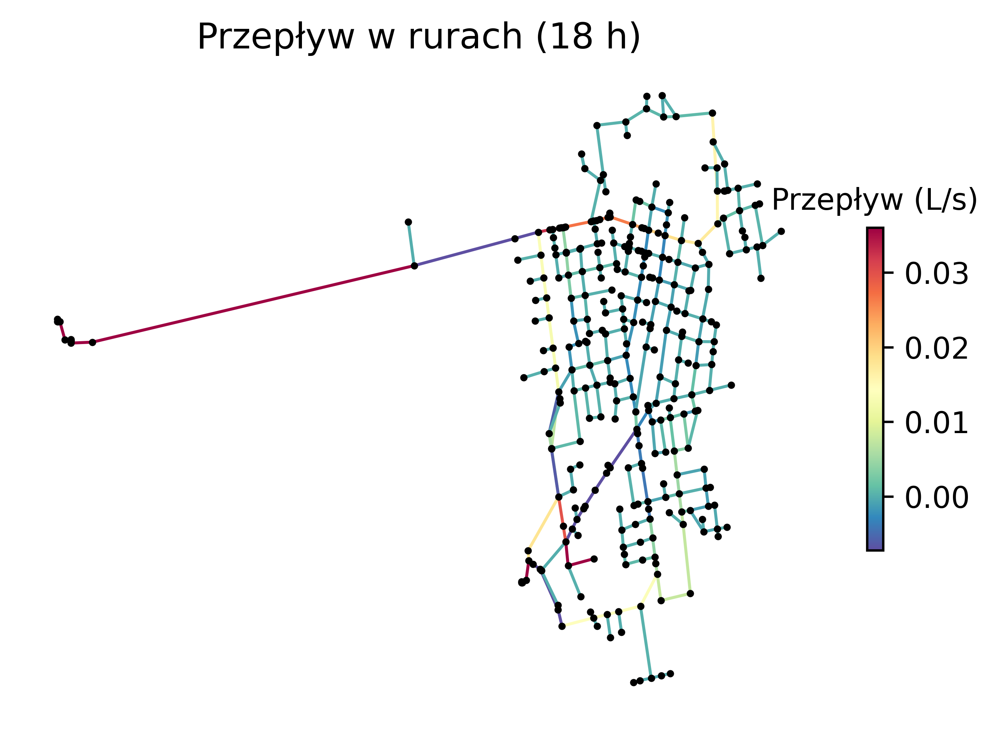

Węzły połączone z węzłem J236: {'J68'}
Rury połączone z węzłem J236: {'P251'}


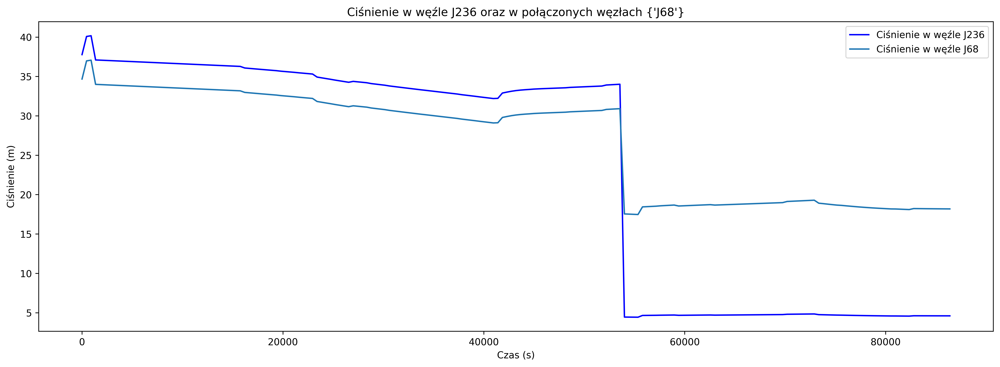

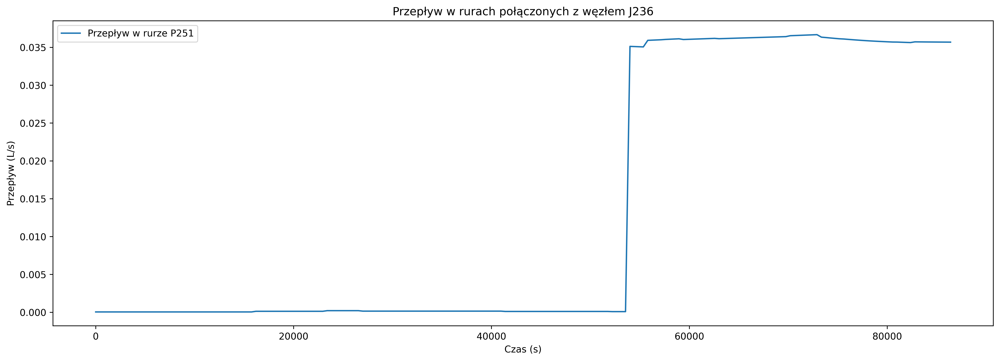

In [8]:
plt.rcParams['figure.dpi'] = 600

def plot_network_pressure(wn, results, time, title, range_min=30, range_max=55):
    """Rysuje wykres ciśnienia w węzłach o podanym czasie i zakresie"""
    pressure = results.node['pressure'].loc[time, :]
    pressure_min = pressure.quantile(0.025)
    pressure_max = pressure.quantile(0.975)
    
    ax = wntr.graphics.plot_network(
        wn,
        node_attribute=pressure,
        node_range=[max(pressure_min, range_min), min(pressure_max, range_max)],
        node_colorbar_label='Ciśnienie (m)',
        node_size=6,
        link_width=0.5
    )
    plt.title(title)
    plt.show()

def plot_network_flow(wn, results, time, title):
    """Rysuje wykres przepływu w linkach o podanym czasie w zakresie 95%"""
    flowrate = results.link['flowrate'].loc[time, :]
    flow_min = flowrate.quantile(0.025)
    flow_max = flowrate.quantile(0.975)
    
    ax = wntr.graphics.plot_network(
        wn,
        link_attribute=flowrate,
        link_range=[flow_min, flow_max],
        link_colorbar_label='Przepływ (L/s)',
        link_width=1,
        node_size=6,
        title=title
    )
    plt.show()


# Główna pętla dla każdego węzła wycieku
for leak_node_number in leak_nodes:
    # Reset sieci
    wn = wntr.network.WaterNetworkModel(inp_file)
    
    # Ustawienia symulacji
    wn.options.time.duration = duration
    wn.options.time.hydraulic_timestep = 450
    wn.options.time.quality_timestep = 450
    wn.options.time.report_timestep = 450
    
    # Aplikowanie wycieku do bieżącego węzła
    leak_node = wn.get_node(leak_node_number)
    leak_node.add_leak(wn, area=leak_area, start_time=leak_start, end_time=leak_end)
    
    # Uruchomienie symulacji
    sim = wntr.sim.WNTRSimulator(wn)
    results = sim.run_sim()
    
    # Rysowanie ciśnienia przed wyciekiem (14 h)
    plot_network_pressure(wn, results, time=14*3600, title="Ciśnienie w sieci przed wyciekiem (14 h)")
    
    # Rysowanie przepływu w rurach przed wyciekiem (14 h)
    plot_network_flow(wn, results, time=14*3600, title="Przepływ w rurach (14 h)")

    # Rysowanie ciśnienia po wycieku (15 h)
    plot_network_pressure(wn, results, time=15*3600, title="Ciśnienie w sieci po wycieku (15 h)")
    
    # Rysowanie przepływu w rurach po wycieku (15 h)
    plot_network_flow(wn, results, time=15*3600, title="Przepływ w rurach (15 h)")

    # Rysowanie ciśnienia po wycieku (18 h)
    plot_network_pressure(wn, results, time=18*3600, title="Ciśnienie w sieci po wycieku (18 h)")
    
    # Rysowanie przepływu w rurach po wycieku (18 h)
    plot_network_flow(wn, results, time=18*3600, title="Przepływ w rurach (18 h)")

    # Pobieranie ciśnienia w głównym węźle wycieku oraz połączonych węzłach
    pressure_at_main_node = results.node['pressure'].loc[:, leak_node_number]
    connected_nodes = set()
    connected_links = set()
    for pipe_name, pipe in wn.links():
        if pipe.start_node_name == leak_node_number:
            connected_nodes.add(pipe.end_node_name)
            connected_links.add(pipe_name)
        elif pipe.end_node_name == leak_node_number:
            connected_nodes.add(pipe.start_node_name)
            connected_links.add(pipe_name)
    
    
    print(f'Węzły połączone z węzłem {leak_node_number}: {connected_nodes}')
    print(f'Rury połączone z węzłem {leak_node_number}: {connected_links}')
    
    
    # Rysowanie ciśnienia dla węzła z wyciekiem i jego połączonych węzłów
    fig, ax1 = plt.subplots(figsize=(18, 6))
    ax1.plot(pressure_at_main_node, label=f"Ciśnienie w węźle {leak_node_number}", color="blue")
    
    for connected_node in connected_nodes:
        pressure_at_connected_node = results.node['pressure'].loc[:, connected_node]
        ax1.plot(pressure_at_connected_node, label=f"Ciśnienie w węźle {connected_node}")
    
    ax1.set_title(f"Ciśnienie w węźle {leak_node_number} oraz w połączonych węzłach {connected_nodes}")
    ax1.set_xlabel("Czas (s)")
    ax1.set_ylabel("Ciśnienie (m)")
    ax1.legend()
    
    
    # Rysowanie przepływów dla rur połączonych z węzłem z wyciekiem
    fig, ax2 = plt.subplots(figsize=(18, 6))
    for link in connected_links:
        flowrate_at_link = results.link['flowrate'].loc[:, link]
        ax2.plot(flowrate_at_link, label=f"Przepływ w rurze {link}")
    
    ax2.set_title(f"Przepływ w rurach połączonych z węzłem {leak_node_number}")
    ax2.set_xlabel("Czas (s)")
    ax2.set_ylabel("Przepływ (L/s)")
    ax2.legend()
    
    plt.show()
